In [5]:
import dask.dataframe as dd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import dask
import datetime as dt
import multiprocessing
import folium
import branca
import branca.colormap as cm
import pylab
import random as rd
import geopandas
import matplotlib.colors as mcolors

from shapely.geometry import Point, Polygon, MultiPolygon
from tqdm.notebook import tqdm
from collections import Counter
from folium.plugins import HeatMap
from folium.plugins import HeatMapWithTime
from folium.features import DivIcon
from sklearn.cluster import DBSCAN
from scipy.spatial import ConvexHull
from sklearn.cluster import KMeans

# Single machine progress bar
from dask.diagnostics import ProgressBar

pd.options.display.precision = 2
#pd.set_option('display.max_columns', None)
nbRowsToDisplay = 100
pd.options.display.min_rows = nbRowsToDisplay
pd.options.display.max_rows = nbRowsToDisplay

plt.rcParams["figure.figsize"] = (20,10)

In [6]:
#Define a function to display an heatmap
Cph_Lat = 12.5683
Cph_Long = 55.6761

#Create a gradient map
steps = 20
#color_map=cm.linear.Accent_07.scale(0,1).to_step(steps)
color_map = cm.LinearColormap(['blue', 'yellow', 'red'],vmin=0, vmax=1)
#color_map1 = cm.LinearColormap(['blue', 'yellow', 'red'],vmin=0, vmax=120)

gradient_map={}
for i in range(steps):
    gradient_map[1/steps*i] = color_map.rgb_hex_str(1/steps*i)

def generateBaseMap(default_location=[Cph_Long, Cph_Lat], default_zoom_start=12):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=12,tiles=None)
    folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(base_map)
    return base_map

def plotHeatmap(latitude,longitude,avgDemand):
    
    heatmap = generateBaseMap() #Base map
    #Heat map
    heatmap.add_child(HeatMap(data=np.vstack((latitude, longitude,avgDemand)).T.tolist(), 
                              radius=7, max_zoom=5,  gradient=gradient_map))
    
    color_map.add_to(heatmap) #Color bar
    
    return heatmap

def plotHeatmapWithTime(data,index):
    
    heatmap = generateBaseMap() #Base map
    
    #Heatmap
    heatmap.add_child(HeatMapWithTime(data, radius=5,index=index,  gradient=gradient_map))
    
    color_map.add_to(heatmap) #Color bar
    
    return heatmap

In [7]:
colorList=list(mcolors.CSS4_COLORS.keys())

def addPointsToMap(my_map,latitudes,longitudes,colors,opacity=0.3,radius=1):
    
    #Add point
    for lat,lon,col in zip(latitudes,longitudes,colors):
        folium.CircleMarker([lat, lon],
                            radius=radius,fill=True,color=col,opacity=opacity
                           ).add_to(my_map)
    
    return my_map

In [8]:
fileDirectory = '/mnt/sdb1/gauthier/jupyter/'

# Let's consider a penetration rate of 5%

In [9]:
def keepTheHighUnservedDemands(df,highUnservedDemandThresh):

    # Check that the high unserved demand are representative of the unserved demand 

    #Calculate the scaled unserved demand
    df['scaledUnservedDemand']=df['unservedDemand']/(df['unservedDemand'].max())

    print("% of kept demand for scaled unserved demands bigger than "+str(highUnservedDemandThresh)+":",
          np.floor(100*df[(df.scaledUnservedDemand>=highUnservedDemandThresh)].scaledUnservedDemand.sum()/df.scaledUnservedDemand.sum()))

    print("% of data kept when removing all scaled unserved demand lower than "+str(highUnservedDemandThresh)+":",
          np.floor(100*len(df[df.scaledUnservedDemand>=highUnservedDemandThresh])/len(df)))

    #Reduce the dataset
    df=df[df.scaledUnservedDemand>=highUnservedDemandThresh]
    
    return df

def findHighUnservedDemandClusters(df,eps,min_samples,unservedDemandRateThresh):

    # Cluster high unserved demand spots

    #Based from https://geoffboeing.com/2014/08/clustering-to-reduce-spatial-data-set-size/
    clustering = DBSCAN(eps=eps, min_samples=min_samples, algorithm='ball_tree', metric='haversine').fit(
        np.radians(df[['endLatitude','endLongitude']]),sample_weight=df.unservedDemand)
    df['cluster']=clustering.labels_

    # Keep the clusters with high demand and vizualise clusters and charging stations

    #Calculate the unserved demand by cluster
    df_unservedDemandByClust=df[['cluster','unservedDemand']].groupby('cluster').sum()

    #Keep the clusters that serve more than x% of the total unserved demand 
    df_unservedDemandByClust['unservedDemandRate']=\
        df_unservedDemandByClust.unservedDemand/df_unservedDemandByClust.unservedDemand.sum()

    df_unservedDemandByClust=\
        df_unservedDemandByClust[(df_unservedDemandByClust.unservedDemandRate>unservedDemandRateThresh)&\
                                 (df_unservedDemandByClust.index!=-1)]

    #Only keep data in the main clusters
    selectedClusters=df_unservedDemandByClust.index
    
    #Assess the unserved demand in the clusters
    print("% unserved demand in the clusters:",
          np.floor(100*df[df.cluster.isin(selectedClusters)].unservedDemand.sum()/df.unservedDemand.sum()))
    
    df=df[df.cluster.isin(selectedClusters)]

    #Create map with clustered points 
    colors=[colorList[clust] for clust in df.cluster]
    map_clusters = generateBaseMap()
    map_clusters = addPointsToMap(map_clusters,df.endLatitude,df.endLongitude,colors,opacity=0.1)
    
    return df, map_clusters

In [10]:
def findchargingStationsInTheClusters(df,df_chargingStations):
    
    #Create a map
    map_clusters = generateBaseMap()

    #Find the convex hull of each cluster
    clusters=df.cluster.unique()
    df_convexHulls=pd.DataFrame(columns=['geometry'])
    c=0

    for clust in clusters:
        #Select the points associated to the cluster 
        points=np.array(df[df.cluster==clust][['endLongitude','endLatitude']])

        # Create the convex hull object
        hull = ConvexHull(points)

        #Save the convex hull for each cluster
        verticesCoord=points[hull.vertices]
        longitudes=[p[0] for p in verticesCoord]
        latitudes=[p[1] for p in verticesCoord]
        df_convexHulls.loc[c,'geometry']= Polygon(zip(longitudes,latitudes ))

        #Add the convex hull to the map
        folium.PolyLine(np.array(list(zip(latitudes,longitudes))),color='black').add_to(map_clusters)

        #increment the counter 
        c+=1

    #Add the charging station on the map
    map_clusters=addPointsToMap(map_clusters,df_chargingStations.latitude,df_chargingStations.longitude,
                               ["black" for c in range(len(df_chargingStations))])
    
    #Find the charging stations in the high unserved demand clusters
    #Convert into a geopandas dataframe
    df_convexHulls['cluster']=clusters
    df_convexHulls = geopandas.GeoDataFrame(df_convexHulls, geometry="geometry")

    #Convert df into a geodataframe 
    df_chargingStations["geometry"] = df_chargingStations.apply(lambda row: Point(row["longitude"], row["latitude"]), axis=1)
    df_chargingStations = geopandas.GeoDataFrame(df_chargingStations, geometry="geometry")

    # Perform the spatial join 
    df_chargingStations = geopandas.tools.sjoin(df_chargingStations, df_convexHulls, how="left", op="within")

    return df_chargingStations, map_clusters

In [11]:
def attributeTheNumberOfOutletsBychargingStations(df_newCS):
    
    nbOutlets=[]
    totalNbOutlets=df_newCS.requiredOutletByCluster
    remainingNbOutlets=totalNbOutlets[0]

    for i in range(len(df_newCS)):
        if remainingNbOutlets==0:
            remainingNbOutlets=totalNbOutlets[i]

        #Attribute the right number of outlets by charging stations
        if remainingNbOutlets==5:
            nbOutlets.append([3])
            remainingNbOutlets-=3
        elif remainingNbOutlets>4:
            nbOutlets.append([4])
            remainingNbOutlets-=4
        else:
            nbOutlets.append([remainingNbOutlets])
            remainingNbOutlets-=remainingNbOutlets
            
    return nbOutlets


def defineTheNewRequiredChargingStations(df,df_chargingStations,meanUtilizationRate,map_clusters):

    #Define a certain amount of energy that has to be supplied for each cluster
    df_clust=df.groupby('cluster').sum().unservedDemand
    df_newCS=pd.DataFrame({'cluster':df_clust.index,'totalUnservedDemand':df_clust.values})
    
    #Find how many cs are required to serve this demand
    df_newCS['requiredOutletByCluster']=round(df_newCS.totalUnservedDemand/(30*24*11*meanUtilizationRate))
    
    # Add new cs to serve the demand
    df_newCS=df_newCS.merge(df_chargingStations.groupby(by='cluster').head(1)[['cluster','areaName']],
                            how='left',on='cluster')

    #Create a line for each new charging station
    #It is assumed that charging stations of 4 outlets are built and then charging stations with fewer outlets if necessary
    df_newCS=pd.DataFrame(
        np.repeat(df_newCS.values,df_newCS.requiredOutletByCluster//4+ np.ceil((df_newCS.requiredOutletByCluster%4)/4)
        ,axis=0),columns=df_newCS.columns)
    
    df_newCS['nbOutlets']=attributeTheNumberOfOutletsBychargingStations(df_newCS)
    
    #Find the centroids of the clusters for each cs
    df_newCS['count']=1
    df_newOutletsByCS=df_newCS.groupby('cluster').sum()['count']

    for i in range(len(df_newOutletsByCS)):

        clust=df_newOutletsByCS.index[i]

        kmeans = KMeans(n_clusters = df_newOutletsByCS.iloc[i], init ='k-means++')
        kmeans.fit(df[df.cluster==clust][['endLatitude','endLongitude']]) # Compute k-means clustering.
        centers = kmeans.cluster_centers_ # Coordinates of cluster centers.

        df_newCS.loc[df_newCS.cluster==clust,'latitude']=centers[:,0]
        df_newCS.loc[df_newCS.cluster==clust,'longitude']=centers[:,1]
        
    
    #Define the attributes for the new cs
    newCSPowerOutlets=[[11] for c in range(len(df_newCS))]
    df_newCS['powerOutlets']=[[11] for c in range(len(df_newCS))]
    df_newCS['supplyByHour']=df_newCS.apply(lambda row:np.multiply(row.powerOutlets,row.nbOutlets)[0],axis=1)
    df_newCS['supplyByMonth']=df_newCS.supplyByHour*24*30
    df_newCS['supplyByMonthForOneHour']=df_newCS.supplyByHour*30

    #Append the new cs to the already existing ones
    df_chargingStations=df_chargingStations.append(
        df_newCS[['areaName','latitude','longitude','cluster','powerOutlets','nbOutlets','supplyByHour','supplyByMonth','supplyByMonthForOneHour']])
    
    #Reset the index
    df_chargingStations=df_chargingStations.reset_index(drop=True)
    
    #Add the new cs to the map
    colors=['black' for c in range(len(df_newCS))]
    map_clusters = addPointsToMap(map_clusters,df_newCS.latitude,df_newCS.longitude,colors,opacity=1,radius=2)
    
    #Plot the mean points of the cluster with the number of new cs
    df_newCS['count']=1
    nbNewCS=df_newCS[['cluster','count']].groupby('cluster').sum()
    centroidLocations=df_newCS[['cluster','latitude','longitude']].groupby('cluster').mean()

    for i in range(len(centroidLocations)):
        folium.map.Marker(
            [centroidLocations.latitude.iloc[i] , centroidLocations.longitude.iloc[i]],
            icon=DivIcon(icon_size=(50,10),icon_anchor=(0,0),html='<div style="font-size: 18pt; color : black">%s</div>' % str(nbNewCS.iloc[i][0]),)
            ).add_to(map_clusters) 

    #Heat map
    df['scaledUnservedDemand']=df.unservedDemand/df.unservedDemand.max()
    data=[np.vstack((df.endLatitude, df.endLongitude,df.scaledUnservedDemand)).T.tolist()]
    map_clusters.add_child(HeatMapWithTime(data=data, radius=5,  index=[1], gradient=gradient_map))
    color_map.add_to(map_clusters) #Color bar
    
    return df_newCS,df_chargingStations,map_clusters

In [16]:
addedCSAtPenetrationRate=0.0216
penetrationRate=0.05
perimeterInKm=1
df=pd.read_pickle(fileDirectory+'data/5_AddNewChargingStations1/df_unservedDemandByHour_experiment3_aggregatedByLocation_penetrationRate='+\
             str(penetrationRate)+'_PerimeterInKm='+str(perimeterInKm)+'_WithMoreCSForPenetratationRate'+\
                    str(addedCSAtPenetrationRate))

df_chargingStations=df_chargingStations=pd.read_pickle(fileDirectory+'data/5_AddNewChargingStations1/df_chargingStations_withUtilizationRate_newCSforPenetrationRate='+
    str(addedCSAtPenetrationRate))

print("% of unserved demand:",np.floor(df.unservedDemand.sum()/df.demand.sum()*100))

% of unserved demand: 29.0


In [17]:
highUnservedDemandThresh=0.01

df = keepTheHighUnservedDemands(df,highUnservedDemandThresh)

data=[np.vstack((df.endLatitude, df.endLongitude,df.scaledUnservedDemand)).T.tolist()]
index=[0.1]
plotHeatmapWithTime(data,index)

% of kept demand for scaled unserved demands bigger than 0.01: 85.0
% of data kept when removing all scaled unserved demand lower than 0.01: 9.0


In [22]:
eps=0.22/6371.
min_samples=2500
unservedDemandRateThresh=0.0
meanUtilizationRate=0.2

#df
df1, map_clusters = findHighUnservedDemandClusters(df,eps,min_samples,unservedDemandRateThresh)
print("Number of clusters:",len(df1.cluster.unique()))

% unserved demand in the clusters: 55.0
Number of clusters: 29


In [23]:
map_clusters

Text(0, 0.5, 'Unserved demand')

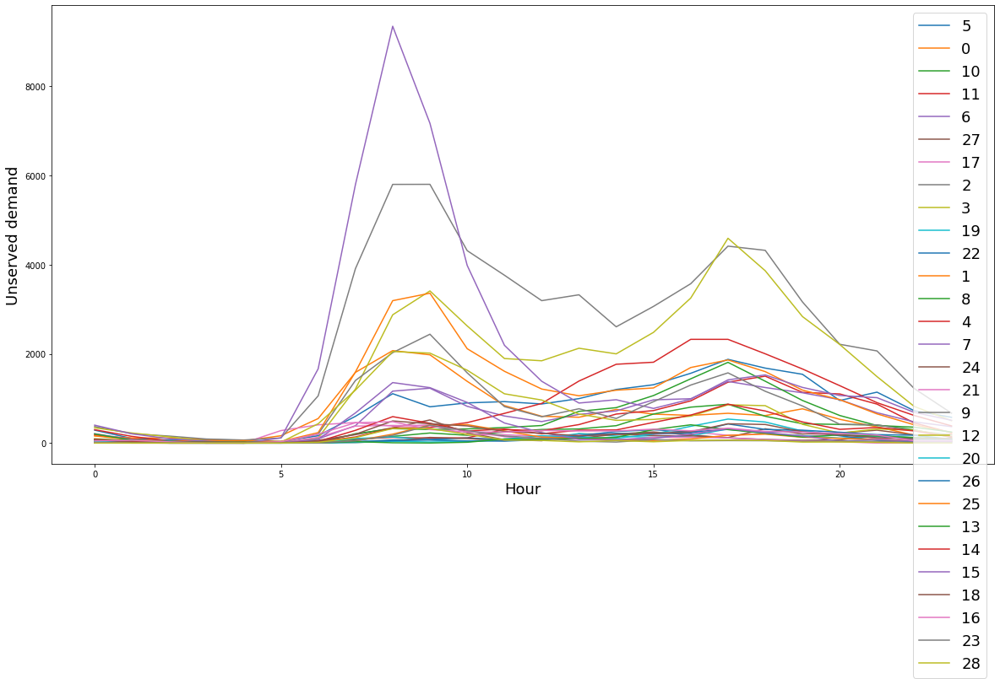

In [24]:
#For each cluster, have a look at the unserved demand through the day
for clu in df1.cluster.unique():
    plt.plot(list(range(24)),df1[df1.cluster==clu][['unservedDemand_h'+str(hour) for hour in range(24)]].sum(),
             label=str(clu))
plt.legend(fontsize=18)
plt.xlabel('Hour',fontsize=18)
plt.ylabel('Unserved demand',fontsize=18)

In [25]:
df_chargingStations, map_clusters = findchargingStationsInTheClusters(df1,df_chargingStations)

#CAREFUL: IT IS CONSIDERED THAT THE DEMAND CORRESPONDS TO ONE MONTH DEMAND! 
df_newCS,df_chargingStations,map_clusters=\
    defineTheNewRequiredChargingStations(df1,df_chargingStations,meanUtilizationRate,map_clusters)

<ipython-input-11-166f6cad77f8>:92: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['scaledUnservedDemand']=df.unservedDemand/df.unservedDemand.max()


In [26]:
map_clusters

In [27]:
df_newCS

,cluster,totalUnservedDemand,requiredOutletByCluster,areaName,nbOutlets,count,latitude,longitude,powerOutlets,supplyByHour,supplyByMonth,supplyByMonthForOneHour
0,0,1.6e+04,10,København S,[4],1,55.66,12.59,[11],44.0,31680.0,1320.0
1,0,1.6e+04,10,København S,[4],1,55.66,12.58,[11],44.0,31680.0,1320.0
2,0,1.6e+04,10,København S,[2.0],1,55.66,12.59,[11],22.0,15840.0,660.0
3,1,2.6e+04,16,København,[4],1,55.71,12.59,[11],44.0,31680.0,1320.0
4,1,2.6e+04,16,København,[4],1,55.71,12.59,[11],44.0,31680.0,1320.0
5,1,2.6e+04,16,København,[4],1,55.71,12.58,[11],44.0,31680.0,1320.0
6,1,2.6e+04,16,København,[4.0],1,55.71,12.59,[11],44.0,31680.0,1320.0
7,2,6e+04,38,København,[4],1,55.66,12.52,[11],44.0,31680.0,1320.0
8,2,6e+04,38,København,[4],1,55.67,12.51,[11],44.0,31680.0,1320.0
9,2,6e+04,38,København,[4],1,55.66,12.50,[11],44.0,31680.0,1320.0


In [28]:
print('% of added supply:',df_newCS.supplyByMonth.sum()/df_chargingStations.supplyByMonth.sum())

% of added supply: 0.18278077097375178


In [29]:
#Compare max demand by hour with supply by hour for a month
df_newCSByCluster=df_newCS.groupby('cluster').sum().supplyByMonthForOneHour
df1_byCluster=df1.groupby('cluster').sum()[['unservedDemand_h' + str(h) for h in range(24)]].max(axis=1)
df1_byCluster.name='maxUnservedDemandByHour'
df_demandVersusSupply=pd.merge(df_newCSByCluster,
    df1_byCluster,
    how='left',left_index=True,right_index=True)

df_demandVersusSupply['supplyDemandRatio']=\
    df_demandVersusSupply.supplyByMonthForOneHour/df_demandVersusSupply.maxUnservedDemandByHour

df_demandVersusSupply[['supplyDemandRatio','maxUnservedDemandByHour']]

,supplyDemandRatio,maxUnservedDemandByHour
cluster,,
0,1.59,2072.40
1,1.57,3359.77
2,2.16,5801.40
3,1.87,4591.95
4,1.84,2325.22
5,2.29,1876.97
6,2.15,1381.78
7,0.99,9346.52
8,1.46,1809.32


In [30]:
hours=range(24)
df_chargingStations=df_chargingStations.drop(['selectedCS','servedDemand','demand']+['servedDemand_h'+str(h) for h in hours],axis=1)
df_chargingStations.index=df_chargingStations.index+1
df_chargingStations=df_chargingStations.drop(['index_right','cluster'],axis=1)
df_chargingStations.to_pickle(fileDirectory+'data/5_AddNewChargingStations1/df_chargingStations_supply_newCSforPenetrationRate='+
    str(penetrationRate))